#### Importamos librerias necesarias

In [10]:
#Importamos librerias necesarias
import pandas as pd
import numpy as np
import seaborn as sns
import os     # Para obtener el directorio activo
from plotly.subplots import make_subplots
import plotly.io as pio
from plotly.offline import plot
import plotly.express as px
import matplotlib.pyplot as plt
import sklearn
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from PIL import Image
from wordcloud import WordCloud
import platform     # Para obtener el sistema operativo
import locale
import folium
from folium.plugins import HeatMap
from scipy.stats import mode
from time import sleep
from retry_requests import retry

pio.templates.default = "plotly_dark"
# Establecer la localización a español
locale.setlocale(locale.LC_TIME, 'es_ES.UTF-8')
pd.set_option('display.max_columns', None) 


In [2]:
import warnings

# Filtrar los FutureWarnings
warnings.filterwarnings("ignore", category=FutureWarning)

In [3]:
# Obtener el nombre del sistema operativo
sistema_operativo = platform.system()
print(sistema_operativo)

Darwin


#### Asignamos la ruta de directorios

In [4]:
#Asignamos el directorio activo
dirActivo = os.getcwd()
# Creamos una carpeta para que contenga a nuestro dataset
if not os.path.isdir('datos'):os.mkdir('datos')
path_datos = os.path.join(dirActivo+'//datos//')
if not os.path.isdir('datos_procesados'):os.mkdir('datos_procesados')
path_datos_procesados = os.path.join(dirActivo+'//datos_procesados//')

Importamos los Dataframes

In [5]:
df = pd.read_csv(f'{path_datos_procesados}accidentes_procesados.csv')
df

,Expediente,Fecha,Día semana,Tipo día,Hora,Tramo horario,Distrito,Tipo de vía,Calle,Latitud,Longitud,Tipo accidente,Estado meteorológico,Tipo vehiculo,Implicado,Sexo,Edad,Lesividad,Positivo alcohol,Positivo droga
0,2018S017842,2019-02-04,lunes,Laborable,09:10:00,Mañana,Chamberí,Calle,Alberto Aguilera,40.429592,-3.706555,Colisión,Despejado,Motocicleta,Conductor,Hombre,40-49,Leve,0,0.0
1,2018S017842,2019-02-04,lunes,Laborable,09:10:00,Mañana,Chamberí,Calle,Alberto Aguilera,40.429592,-3.706555,Colisión,Despejado,Turismo,Conductor,Mujer,30-39,Leve,0,0.0
2,2019S000001,2019-01-01,martes,Festivo,03:45:00,Madrugada,Carabanchel,Calle,Antonio De Leyva,40.385903,-3.717037,Colisión,Despejado,Turismo,Conductor,Hombre,40-49,Muy leve,1,0.0
3,2019S000001,2019-01-01,martes,Festivo,03:45:00,Madrugada,Carabanchel,Calle,Antonio De Leyva,40.385903,-3.717037,Colisión,Despejado,Turismo,Conductor,Mujer,40-49,Muy leve,0,0.0
4,2019S000001,2019-01-01,martes,Festivo,03:45:00,Madrugada,Carabanchel,Calle,Antonio De Leyva,40.385903,-3.717037,Colisión,Despejado,Turismo,Conductor,Mujer,40-49,Muy leve,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238102,2024S015161,2024-04-30,martes,Laborable,22:47:00,Noche,Salamanca,Calle,Rufino Blanco,40.426675,-3.665416,Colisión,Despejado,Turismo,Conductor,Hombre,18-29,Leve,0,0.0
238103,2024S015162,2024-04-30,martes,Laborable,23:18:00,Noche,Salamanca,Calle,Rufino Blanco,40.426675,-3.665416,Colisión,Nublado,Vehiculo Pesado,Conductor,Hombre,40-49,Muy leve,0,0.0
238104,2024S015162,2024-04-30,martes,Laborable,23:18:00,Noche,Salamanca,Calle,Rufino Blanco,40.426675,-3.665416,Colisión,Nublado,Turismo,Conductor,Hombre,50-59,Muy leve,0,0.0
238105,2024S015164,2024-04-30,martes,Laborable,23:15:00,Noche,Fuencarral - El Pardo,Avenida,Monforte De Lemos,40.479788,-3.702582,Otro,Despejado,Turismo,Conductor,Hombre,18-29,Grave,0,0.0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 238107 entries, 0 to 238106
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Expediente            238107 non-null  object 
 1   Fecha                 238107 non-null  object 
 2   Día semana            238107 non-null  object 
 3   Tipo día              238107 non-null  object 
 4   Hora                  238107 non-null  object 
 5   Tramo horario         238107 non-null  object 
 6   Distrito              238107 non-null  object 
 7   Tipo de vía           238107 non-null  object 
 8   Calle                 238107 non-null  object 
 9   Latitud               238107 non-null  float64
 10  Longitud              238107 non-null  float64
 11  Tipo accidente        238107 non-null  object 
 12  Estado meteorológico  238107 non-null  object 
 13  Tipo vehiculo         238107 non-null  object 
 14  Implicado             238107 non-null  object 
 15  

In [7]:
df_HE = pd.read_csv(f'{path_datos_procesados}accidentes_procesados.csv')
df_HE

,Expediente,Fecha,Día semana,Tipo día,Hora,Tramo horario,Distrito,Tipo de vía,Calle,Latitud,Longitud,Tipo accidente,Estado meteorológico,Tipo vehiculo,Implicado,Sexo,Edad,Lesividad,Positivo alcohol,Positivo droga
0,2018S017842,2019-02-04,lunes,Laborable,09:10:00,Mañana,Chamberí,Calle,Alberto Aguilera,40.429592,-3.706555,Colisión,Despejado,Motocicleta,Conductor,Hombre,40-49,Leve,0,0.0
1,2018S017842,2019-02-04,lunes,Laborable,09:10:00,Mañana,Chamberí,Calle,Alberto Aguilera,40.429592,-3.706555,Colisión,Despejado,Turismo,Conductor,Mujer,30-39,Leve,0,0.0
2,2019S000001,2019-01-01,martes,Festivo,03:45:00,Madrugada,Carabanchel,Calle,Antonio De Leyva,40.385903,-3.717037,Colisión,Despejado,Turismo,Conductor,Hombre,40-49,Muy leve,1,0.0
3,2019S000001,2019-01-01,martes,Festivo,03:45:00,Madrugada,Carabanchel,Calle,Antonio De Leyva,40.385903,-3.717037,Colisión,Despejado,Turismo,Conductor,Mujer,40-49,Muy leve,0,0.0
4,2019S000001,2019-01-01,martes,Festivo,03:45:00,Madrugada,Carabanchel,Calle,Antonio De Leyva,40.385903,-3.717037,Colisión,Despejado,Turismo,Conductor,Mujer,40-49,Muy leve,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238102,2024S015161,2024-04-30,martes,Laborable,22:47:00,Noche,Salamanca,Calle,Rufino Blanco,40.426675,-3.665416,Colisión,Despejado,Turismo,Conductor,Hombre,18-29,Leve,0,0.0
238103,2024S015162,2024-04-30,martes,Laborable,23:18:00,Noche,Salamanca,Calle,Rufino Blanco,40.426675,-3.665416,Colisión,Nublado,Vehiculo Pesado,Conductor,Hombre,40-49,Muy leve,0,0.0
238104,2024S015162,2024-04-30,martes,Laborable,23:18:00,Noche,Salamanca,Calle,Rufino Blanco,40.426675,-3.665416,Colisión,Nublado,Turismo,Conductor,Hombre,50-59,Muy leve,0,0.0
238105,2024S015164,2024-04-30,martes,Laborable,23:15:00,Noche,Fuencarral - El Pardo,Avenida,Monforte De Lemos,40.479788,-3.702582,Otro,Despejado,Turismo,Conductor,Hombre,18-29,Grave,0,0.0


In [8]:
# Eliminar la columna 'Expediente' del DataFrame
df_HE = df_HE.drop(columns=['Expediente', 'Fecha', 'Hora', 'Calle', 'Latitud', 'Longitud'])

In [9]:
df_HE.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 238107 entries, 0 to 238106
Data columns (total 14 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Día semana            238107 non-null  object 
 1   Tipo día              238107 non-null  object 
 2   Tramo horario         238107 non-null  object 
 3   Distrito              238107 non-null  object 
 4   Tipo de vía           238107 non-null  object 
 5   Tipo accidente        238107 non-null  object 
 6   Estado meteorológico  238107 non-null  object 
 7   Tipo vehiculo         238107 non-null  object 
 8   Implicado             238107 non-null  object 
 9   Sexo                  238107 non-null  object 
 10  Edad                  238107 non-null  object 
 11  Lesividad             238107 non-null  object 
 12  Positivo alcohol      238107 non-null  int64  
 13  Positivo droga        238107 non-null  float64
dtypes: float64(1), int64(1), object(12)
memory usage: 25

In [11]:
# Inicializar el codificador de etiquetas
label_encoder = LabelEncoder()

# Iterar sobre cada columna que deseas codificar
for columna in df_HE.columns:
    if df_HE[columna].dtype == 'object':  # Verificar si la columna es de tipo objeto (cadena)
        df_HE[columna] = label_encoder.fit_transform(df_HE[columna])

In [12]:
df_HE

,Día semana,Tipo día,Tramo horario,Distrito,Tipo de vía,Tipo accidente,Estado meteorológico,Tipo vehiculo,Implicado,Sexo,Edad,Lesividad,Positivo alcohol,Positivo droga
0,2,2,1,5,4,2,0,4,0,0,4,2,0,0.0
1,2,2,1,5,4,2,0,7,0,1,3,2,0,0.0
2,3,0,0,2,4,2,0,7,0,0,4,3,1,0.0
3,3,0,0,2,4,2,0,7,0,1,4,3,0,0.0
4,3,0,0,2,4,2,0,7,0,1,4,3,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
238102,3,2,2,14,4,2,0,7,0,0,2,2,0,0.0
238103,3,2,2,14,4,2,4,8,0,0,4,3,0,0.0
238104,3,2,2,14,4,2,4,7,0,0,5,3,0,0.0
238105,3,2,2,7,2,3,0,7,0,0,2,1,0,0.0


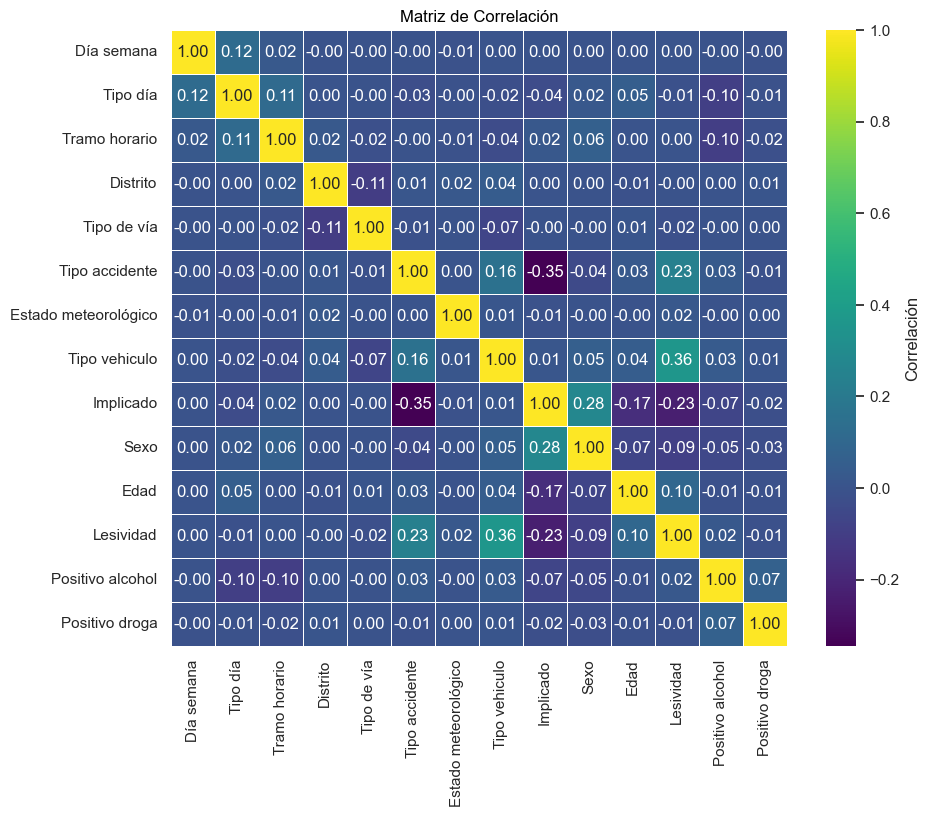

In [21]:
corr = df_HE.corr(method = 'pearson').sort_values(by = 'Lesividad', axis = 0, ascending = False).sort_values(by = 'Lesividad', axis = 1, ascending = False)

# Configurar el estilo de Seaborn similar a plotly_dark
plt.figure(figsize=(10, 8))
sns.set(style="darkgrid")
sns.set_palette("viridis")

# Crear el heatmap con Seaborn
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="viridis", linewidths=0.5, 
            cbar_kws={'label': 'Correlación'}, square=True)

# Configuraciones adicionales
plt.title("Matriz de Correlación", color="black")

# Mostrar el heatmap
plt.show()

In [22]:
# Guardar el gráfico como un archivo PNG
plt.('correlacion.png', format='png')

<Figure size 640x480 with 0 Axes>

### Borramos columnas 

In [7]:
df.columns

Index(['Expediente', 'Fecha', 'Día semana', 'Tipo día', 'Hora',
       'Tramo horario', 'Distrito', 'Tipo de vía', 'Calle', 'Latitud',
       'Longitud', 'Tipo accidente', 'Estado meteorológico', 'Tipo vehiculo',
       'Implicado', 'Sexo', 'Edad', 'Lesividad', 'Positivo alcohol',
       'Positivo droga'],
      dtype='object')

In [8]:
try:
    df.dorp(columns=['localización', 'número', 'cod_distrito', 'distrito','rango_edad', 'cod_lesividad', 'coordenadas_x_utm', 'coordenadas_y_utm',
                'Tipo de Festivo', 'Festividad', 'tipo_via', 'callero_distrito' ], inplace=True)
    
except: 
    pass

### Tipo de vehículo

#### Distribución de tipos de accidente por tipo de vehículo

In [9]:
# Agrupar los datos por tipo de vehículo y tipo de accidente y contar los valores únicos de 'Expediente' para asi sacar la cantidad de accidentes
grouped_df = df.groupby(['Tipo vehiculo', 'Tipo accidente'])['Expediente'].nunique().reset_index(name='count')

# Crear una nueva columna para etiquetas que combine tipo de accidente y cantidad
grouped_df['label'] = grouped_df['Tipo accidente'] + ': ' + grouped_df['count'].astype(str)

# Crear el gráfico de treemap con Plotly
fig = px.treemap(grouped_df, path=['Tipo vehiculo', 'label'], values='count', 
                title='Distribución de tipos de accidente por tipo de vehículo',
                color='count', color_continuous_scale='Blues',
                hover_data={'count': True},
                labels={'Tipo vehiculo': 'Tipo de vehículo', 'label': 'Tipo de accidente y cantidad', 'count': 'Cantidad'})

# Ajustar el diseño del gráfico
fig.update_layout(
    title_font_size=20,
    title_font_family='Arial',
    margin=dict(t=50, l=25, r=25, b=25)
)

# Mostrar el gráfico
fig.show()

# Guardar el mapa en un archivo HTML
fig.write_html('treemap.html')

#### Número de accidentes por tipo de vehículo

In [10]:
# Contar el número de accidentes únicos por tipo de vehículo y ordenar de mayor a menor
accidentes_por_vehiculo = df.groupby('Tipo vehiculo')['Expediente'].nunique().reset_index()
accidentes_por_vehiculo = accidentes_por_vehiculo.sort_values(by='Expediente', ascending=False)

# Crear el gráfico de barras horizontal usando plotly.express
fig1 = px.bar(accidentes_por_vehiculo,
            x='Expediente',
            y='Tipo vehiculo',
            orientation='h',
            text='Expediente',
            color='Expediente',
            color_continuous_scale='Blues',
            title='Número de accidentes por tipo de vehículo')

# Actualizar el diseño del gráfico
fig1.update_layout(
    xaxis_title='Número de accidentes',
    yaxis_title='Tipo de vehículo',
    template='plotly_dark',  # Mantener la plantilla oscura para una mejor visibilidad
    font=dict(family='Arial', size=12, color='white'),  # Personalizar la fuente
    margin=dict(l=100, r=50, t=80, b=50)  # Ajustar los márgenes
)

# Mostrar el gráfico
fig1.show()


#### Relación entre el tipo de accidente y el vehículo

In [11]:
# Crear una tabla de frecuencia cruzada (crosstab), para contar la frecuencia de cada combinación.
crosstab = pd.crosstab(df['Tipo accidente'], df['Tipo vehiculo'])

# Convertir la tabla crosstab en un DataFrame para usar con plotly
crosstab_reset = crosstab.reset_index()

# Usar plotly.express para crear el heatmap interactivo
fig = px.imshow(crosstab.values, 
                labels=dict(x="Tipo de Vehículo", y="Tipo de Accidente", color="Frecuencia"),
                x=crosstab.columns, 
                y=crosstab.index,
                color_continuous_scale='Blues',
                aspect="auto",
                text_auto=True)  # Esta línea agrega los números en las casillas

# Personalizar el título y las etiquetas
fig.update_layout(
    title='Relación entre Tipo de Accidente y Tipo de Vehículo',
    xaxis_title='Tipo de Vehículo',
    yaxis_title='Tipo de Accidente'
)

# Mostrar el gráfico interactivo
fig.show()


In [12]:
# Crear una tabla de frecuencia cruzada (crosstab), para contar la frecuencia de cada combinación.
crosstab = pd.crosstab(df['Tipo accidente'], df['Tipo vehiculo'])

# Convertir la tabla crosstab en un DataFrame para usar con plotly
crosstab_reset = crosstab.reset_index()

# Usar plotly.express para crear el heatmap interactivo
fig = px.imshow(crosstab.values, 
                labels=dict(x="Tipo de Vehículo", y="Tipo de Accidente", color="Frecuencia"),
                x=crosstab.columns, 
                y=crosstab.index,
                color_continuous_scale='ice',
                aspect="auto")

# Personalizar el título y las etiquetas
fig.update_layout(
    title='Relación entre Tipo de Accidente y Tipo de Vehículo',
    xaxis_title='Tipo de Vehículo',
    yaxis_title='Tipo de Accidente'
)

# Mostrar el gráfico interactivo
fig.show()


#### Distribución de accidentes por tipo de vehículo y género

In [13]:
import pandas as pd
import plotly.graph_objects as go

# Agrupar por sexo y tipo de vehículo contando por las filas del df
grouped_sexo_vehiculo = df.groupby(['Sexo', 'Tipo vehiculo']).size().reset_index(name='count').sort_values('count', ascending=False)

# Definir una lista de colores azules para cada sexo
colors = {'Hombre': 'blue', 'Mujer': 'turquoise'}  # Puedes personalizar los tonos de azul según tu preferencia

# Crear figura combinada de barras y líneas
fig = go.Figure()

# Añadir barras para accidentes por tipo de vehículo y género
for sexo in grouped_sexo_vehiculo['Sexo'].unique():
    sexo_df = grouped_sexo_vehiculo[grouped_sexo_vehiculo['Sexo'] == sexo]
    fig.add_trace(go.Bar(
        x=sexo_df['Tipo vehiculo'],
        y=sexo_df['count'],
        name=f'{sexo} (Accidentes)',
        marker=dict(color=colors[sexo]),  # Asignar un color específico para cada sexo
        text=sexo_df['count'],
        textposition='auto'
    ))

# Mejorar el diseño del gráfico
fig.update_layout(
    title='Distribución de accidentes por tipo de vehículo y género',
    xaxis_title='Tipo de vehículo',
    yaxis_title='Cantidad de accidentes',
    barmode='group',
    legend_title='Género y tipo de accidente',
    plot_bgcolor='rgba(0,0,0,0)',
    xaxis=dict(showgrid=False),
    yaxis=dict(showgrid=False, gridcolor='white'),
    font=dict(family='Arial', size=12, color='white'),
    margin=dict(l=50, r=50, t=80, b=50),
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    template='plotly_dark'  # Usar un template con tonos de azul
)

# Mostrar el gráfico
fig.show()

In [14]:
# Agrupar por sexo y tipo de vehículo contando por las filas del df
grouped_sexo_vehiculo = df.groupby(['Sexo', 'Tipo vehiculo']).size().reset_index(name='count').sort_values('count', ascending=False)

# Crear figura combinada de barras y líneas
fig = go.Figure()
# Definir una lista de colores azules para cada sexo
colors = {'Hombre': 'blue', 'Mujer': 'turquoise'}  # Puedes personalizar los tonos de azul según tu preferencia

# Añadir barras para accidentes por tipo de vehículo y género
for sexo in grouped_sexo_vehiculo['Sexo'].unique():
    sexo_df = grouped_sexo_vehiculo[grouped_sexo_vehiculo['Sexo'] == sexo]
    fig.add_trace(go.Bar(
        x=sexo_df['Tipo vehiculo'],
        y=sexo_df['count'],
        name=f'{sexo} (Accidentes)',
        marker=dict(line=dict(width=1)),
        text=sexo_df['count'],
        textposition='auto'
    ))

# Mejorar el diseño del gráfico
fig.update_layout(
    title='Distribución de accidentes por tipo de vehículo y género',
    xaxis_title='Tipo de vehículo',
    yaxis_title='Cantidad de accidentes',
    barmode='group',
    legend_title='Género y tipo de accidente',
    plot_bgcolor='rgba(0,0,0,0)',
    xaxis=dict(showgrid=False),
    yaxis=dict(showgrid=False, gridcolor='white'),
    font=dict(family='Arial', size=12, color='white'),
    margin=dict(l=50, r=50, t=80, b=50),
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1)
)

# Mostrar el gráfico
fig.show()

### Lesividad

#### Accidentes por Lesividad

In [15]:
# Agrupar los datos para obtener la cantidad y el porcentaje
lesividad = df.groupby(['Lesividad']).size().reset_index(name='cantidad')
suma_total = lesividad['cantidad'].sum()
lesividad['porcentaje'] = (lesividad['cantidad'] / suma_total) * 100

# Ordenar de mayor a menor
lesividad.sort_values(by='cantidad', ascending=False, inplace=True)

# Crear la figura
fig = go.Figure()

# Definir una paleta de colores
colores = ['blue', 'lightblue', 'royalblue', 'darkblue', 'steelblue', 'aliceblue', 'azure', 'cyan']

# Agregar el gráfico de barras
for i, row in lesividad.iterrows():
    fig.add_trace(go.Bar(
        x=[row['Lesividad']],
        y=[row['cantidad']],
        text=[f"{row['porcentaje']:.2f}%"],
        marker_color=colores[i % len(colores)]
    ))

# Actualizar el diseño del gráfico
fig.update_layout(
    title="Accidentes por Lesividad",
    xaxis_title="Lesividad",
    yaxis_title="Cantidad",
    uniformtext=dict(mode="hide", minsize=10),
    showlegend=False  # No mostrar leyenda
)

# Mostrar el gráfico
fig.show()




In [16]:
# Agrupar los datos para obtener la cantidad y el porcentaje
lesividad = df.groupby(['Lesividad']).size().reset_index(name='cantidad')
suma_total = lesividad['cantidad'].sum()
lesividad['porcentaje'] = (lesividad['cantidad'] / suma_total) * 100

# Crear el gráfico de violín
fig = px.violin(lesividad, y='Lesividad', x='cantidad', color='Lesividad', box=True, points="all",
                title='Distribución de Lesiones (Gráfico de Violín)')

# Mostrar el gráfico
fig.show()


#### Accidentes por Tipo Lesividad

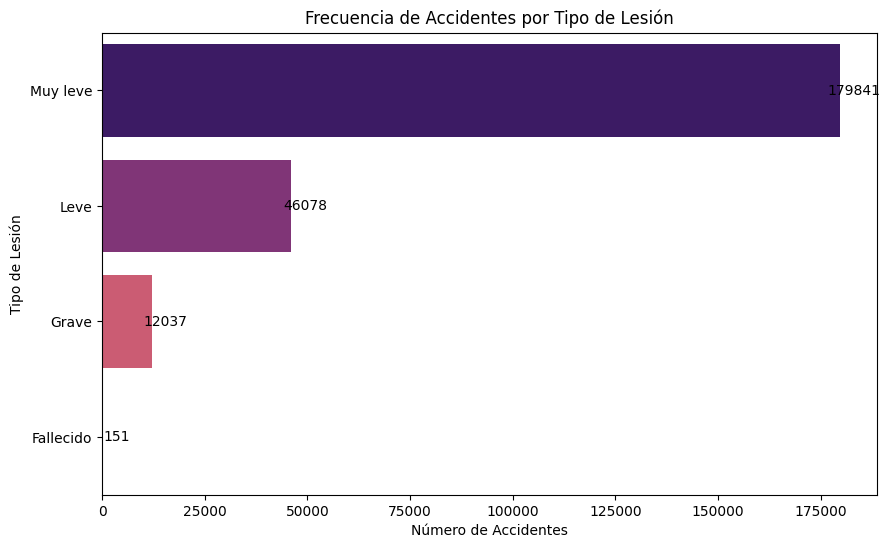

In [17]:
# Crear el gráfico de barras con Seaborn
plt.figure(figsize=(10, 6))
ax = sns.countplot(data=df, y='Lesividad', order=df['Lesividad'].value_counts().index, palette='magma')

# Añadir etiquetas con el número de accidentes en cada barra
for p in ax.patches:
    ax.annotate(format(p.get_width(), '.0f'), 
                (p.get_width(), p.get_y() + p.get_height() / 2), 
                ha = 'center', 
                va = 'center', 
                xytext = (10, 0), 
                textcoords = 'offset points')

# Personalizar el gráfico
plt.title('Frecuencia de Accidentes por Tipo de Lesión')
plt.xlabel('Número de Accidentes')
plt.ylabel('Tipo de Lesión')
plt.show();


In [18]:
# Agrupamos los datos para ver las clasificaciones con la cantidad y el %
lesividad = df.groupby(['Lesividad']).size().reset_index(name='cantidad')
suma_total = lesividad['cantidad'].sum()
lesividad['porcentaje'] = (lesividad['cantidad'] / suma_total) * 100
lesividad.sort_values('cantidad', ascending=False, inplace=True)

# Crear el gráfico de barras
fig = go.Figure()
fig.add_trace(go.Bar(
    x=lesividad['Lesividad'],
    y=lesividad['cantidad'],
    marker_color='indianred',  # Cambiar el color de las barras
    text=lesividad['porcentaje'].round(2).astype(str) + '%',
    textposition='auto',  # Colocar automáticamente el texto
    name='Accidentes por Tipo Lesividad'
))

# Actualizar el diseño del gráfico
fig.update_layout(
    title_text="Accidentes por Tipo Lesividad",
    xaxis_title="Tipo de Lesividad",
    yaxis_title="Cantidad de Accidentes",
    uniformtext_minsize=10,  # Tamaño mínimo del texto en las barras
    uniformtext_mode='hide',  # Ocultar el texto cuando es demasiado pequeño
    plot_bgcolor='rgba(0,0,0,0)',  # Fondo transparente
    paper_bgcolor='rgba(0,0,0,0)',  # Fondo transparente
    bargap=0.2,  # Espacio entre las barras
)

# Mostrar el gráfico
fig.show()


#### Distribución de edades según Tipo de Lesividad

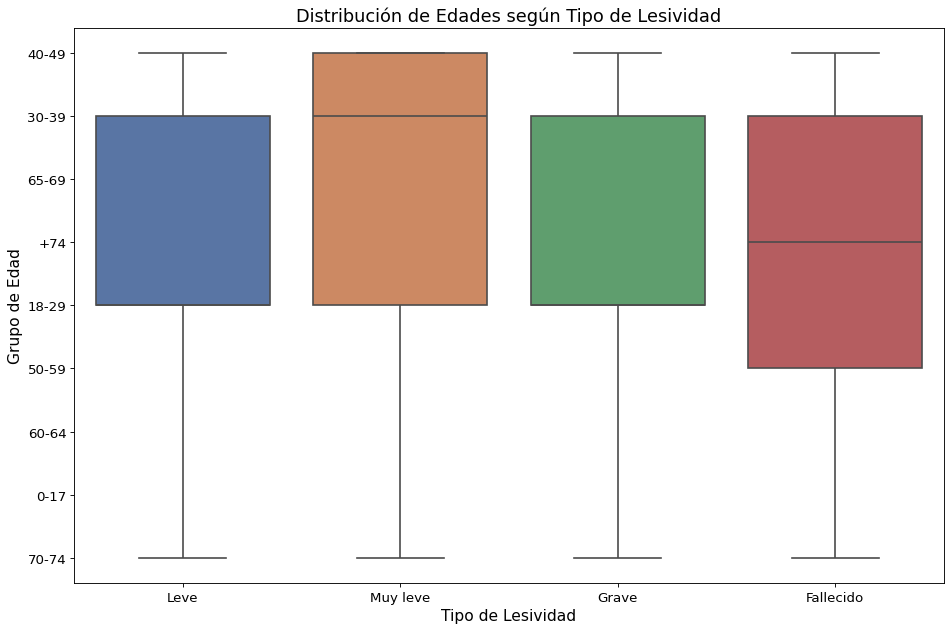

In [19]:
# Definir el orden de los grupos de edad
edad_order = ['0-17', '18-29', '30-39', '40-49', '50-59', '60-64', '65-69', '70-74', '75+']

# Convertir la columna Edad a tipo categórico con el orden específico
#df_filtered['Edad'] = pd.Categorical(df_filtered['Edad'], categories=edad_order, ordered=True)

# Establecer el tamaño y la resolución del gráfico
plt.figure(figsize=(12, 8), dpi=80)

# Crear el boxplot con Seaborn
sns.boxplot(x='Lesividad', y='Edad', data=df, linewidth=1.5, palette='deep')

# Agregar título y etiquetas de los ejes
plt.title('Distribución de Edades según Tipo de Lesividad', fontsize=16)
plt.xlabel('Tipo de Lesividad', fontsize=14)
plt.ylabel('Grupo de Edad', fontsize=14)

# Ajustar las etiquetas de los ejes
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

Este gráfico nos proporcionará información sobre cómo varía la distribución de edades entre las diferentes categorías de gravedad de las lesiones. Podríamos sacar conclusiones sobre si ciertos grupos de edad están más expuestos a lesiones graves en comparación con otros, lo que podría ser útil para orientar medidas de seguridad vial y programas de prevención.

### Tipo de Accidente

#### Número de accidentes según su tipo

In [20]:
df.columns

Index(['Expediente', 'Fecha', 'Día semana', 'Tipo día', 'Hora',
       'Tramo horario', 'Distrito', 'Tipo de vía', 'Calle', 'Latitud',
       'Longitud', 'Tipo accidente', 'Estado meteorológico', 'Tipo vehiculo',
       'Implicado', 'Sexo', 'Edad', 'Lesividad', 'Positivo alcohol',
       'Positivo droga'],
      dtype='object')

In [21]:
# Contar el número de accidentes por tipo de accidente
tipo_accidente_counts = df['Tipo accidente'].value_counts()

# Crear el gráfico de barras horizontales
fig = px.bar(x=tipo_accidente_counts.values, 
            y=tipo_accidente_counts.index, 
            orientation='h', 
            title='Distribución de Tipos de Accidente',
            labels={'index': 'Tipo de Accidente', 'Tipo accidente': 'Número de Accidentes'},
            color=tipo_accidente_counts.values,
            color_continuous_scale='magma')

# Actualizar el diseño del gráfico
fig.update_layout(xaxis_title='Número de Accidentes',
                yaxis_title='Tipo de Accidente',
                yaxis={'categoryorder': 'total ascending'})



fig.show()

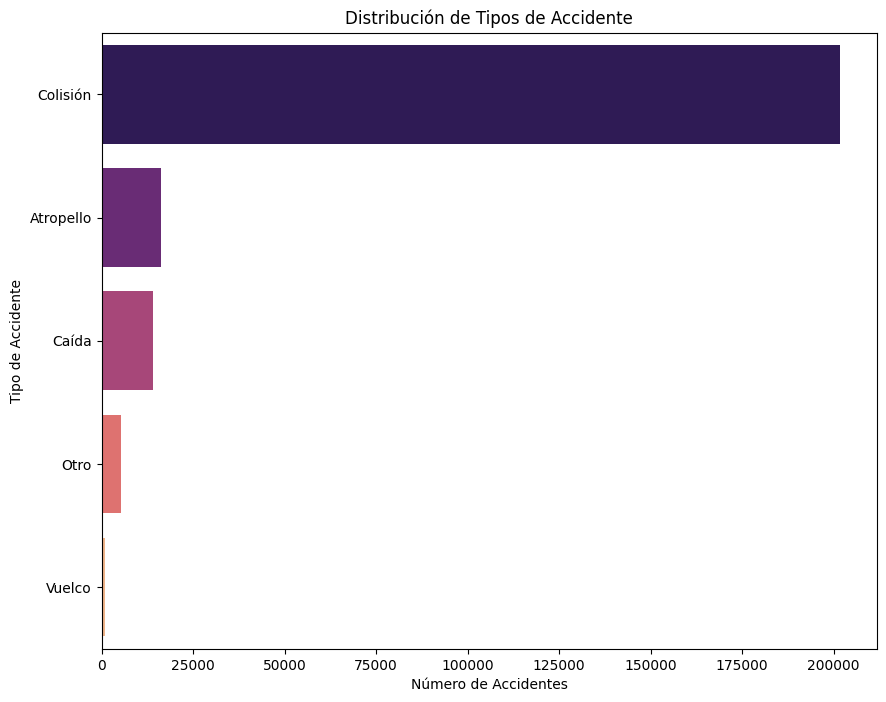

In [22]:
# Aumentar el tamaño del gráfico
plt.figure(figsize=(10, 8))

# Crear el gráfico de barras horizontales
sns.countplot(data=df, y='Tipo accidente', order=df['Tipo accidente'].value_counts().index, palette='magma')
plt.title('Distribución de Tipos de Accidente')
plt.xlabel('Número de Accidentes')
plt.ylabel('Tipo de Accidente')
plt.show()

#### Tipo de accidente por tipo de via

In [23]:
# Agrupar los datos por tipo de vía y tipo de accidente, contando los valores únicos de 'Expediente' para obtener la cantidad de accidentes por cada combinación
grouped_df = df.groupby(['Tipo de vía', 'Tipo accidente'])['Expediente'].nunique().reset_index(name='count')

# Crear el gráfico de área apilada con Plotly
fig = px.area(grouped_df, x='Tipo de vía', y='count', color='Tipo accidente',
            title='Distribución de tipos de accidente por tipo de vía',
            labels={'Tipo de vía': 'Tipo de Vía', 'count': 'Cantidad'},
            category_orders={'Tipo de vía': grouped_df['Tipo de vía'].unique(), 'Tipo accidente': grouped_df['Tipo accidente'].unique()})

fig.update_layout(
    title={
        'text': 'Distribución de Tipos de accidente por Tipo de Vía y Tipo de Accidente',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    }
)

# Mostrar el gráfico
fig.show()

### Tipo de Persona

#### tipo de persona sin ser fallecido

#### Fallecidos por Tipo de Persona y Sexo

In [24]:
# Filtrar el DataFrame para incluir solo las filas con tipo de lesividad "Grave" o "Fallecido"
df_fallecidos = df[df['Lesividad']=='Fallecido']

# Agrupar por tipo de lesividad y tipo de persona y contar las ocurrencias
fallecidos_tpPersona = df_fallecidos.groupby(['Tipo accidente']).size().reset_index(name='cantidad')
fallecidos_sexo = df_fallecidos.groupby(['Sexo']).size().reset_index(name='cantidad')


fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=fallecidos_tpPersona['Tipo accidente'].values,
                            values=fallecidos_tpPersona['cantidad'].values,
                            name='',textinfo='label+percent',showlegend=False,hole=.3),1,1)

fig.add_trace(go.Pie(labels=fallecidos_sexo['Sexo'].values,
                            values=fallecidos_sexo['cantidad'].values,
                            name='',textinfo='label+percent',showlegend=False,hole=.3),1,2)
# Actualizar el diseño del gráfico
fig.update_layout(
    title_text="Fallecidos en accidentes por Tipo Persona y Sexo"
)
# Mostrar la figura
fig.show()





In [25]:
# Agrupar y sumar las frecuencias por tipo de accidente
grouped_df = df.groupby('Tipo accidente')['Implicado'].value_counts().unstack(fill_value=0)

# Crear el gráfico interactivo
fig = px.bar(grouped_df, 
            barmode='stack',
            labels={'Tipo accidente': 'Tipo de Accidente', 'value': 'Número de Accidentes', 'Implicado': 'Tipo de Persona'},
            color_discrete_sequence=px.colors.sequential.Plasma)

fig.update_layout(title='Distribución de Tipos de Accidente por Tipo de Persona',
                xaxis_title='',
                yaxis_title='Número de Accidentes',
                legend_title='Tipo de Persona')


fig.show()

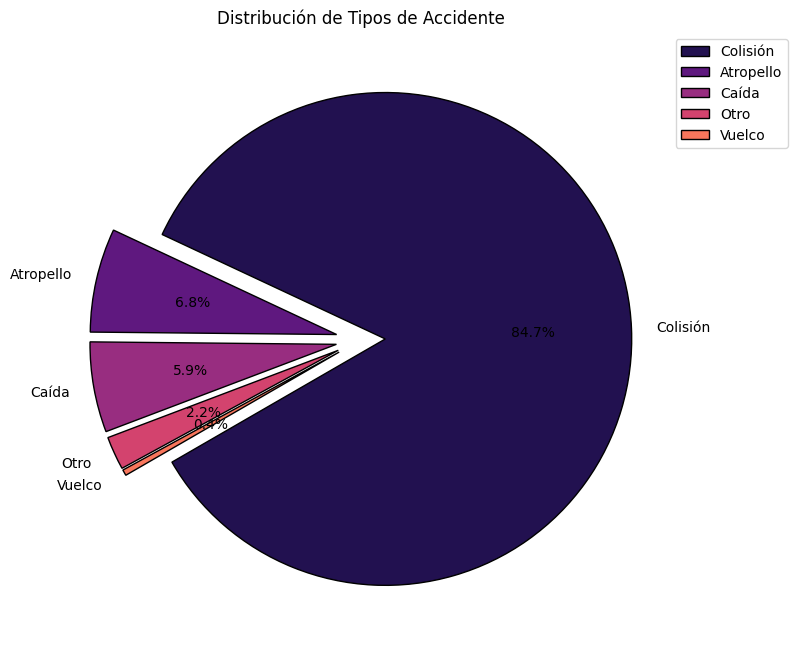

In [26]:
# Calcular el número de categorías en los datos
num_categorias = len(df['Tipo accidente'].unique())

# Crear la lista 'explode' con la misma longitud que el número de categorías
explode = [0.1] * num_categorias  # Por ejemplo, separar todas las porciones del pastel en un 10%

# Aumentar el tamaño del gráfico
plt.figure(figsize=(10, 8))

# Crear el gráfico de pastel
pie = df['Tipo accidente'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=210, colors=sns.color_palette('magma'), wedgeprops={'edgecolor': 'black'}, explode=explode, textprops={'fontsize': 10})

# Añadir etiquetas fuera del pastel
plt.legend(bbox_to_anchor=(1, 1), loc='upper left')
plt.title('Distribución de Tipos de Accidente')
plt.ylabel('')
plt.show()


#### Accidentes por tipo de lesividad y hora

In [27]:
# Agrupar por fecha, tramo horario y tipo de lesividad y contar las ocurrencias
total_por_dia_horario_lesividad = df.groupby(['Día semana', 'Tramo horario', 'Lesividad'])['Expediente'].nunique().reset_index(name='cantidad')
total_por_dia_horario_lesividad.rename(columns={'Lesividad': 'Tipo Lesividad','Tramo horario':'Horario','Día semana':'Día'}, inplace=True)

# Crear gráfico de barras agrupado
fig = px.bar(total_por_dia_horario_lesividad, x='Día', y='cantidad', color='Tipo Lesividad', facet_row='Horario',
            title='Accidentes y tipo de lesividad por día y tramo horario',
            labels={'Fecha': 'Fecha', 'cantidad': 'Accidentes'},
            category_orders={'Día':['lunes','martes','miércoles','jueves','viernes','sábado','domingo'],'Horario': ['Mañana', 'Tarde', 'Noche']})

# Ajustar tamaño y espaciado de la figura
fig.update_layout(height=800, width=1000, margin=dict(l=20, r=20, t=70, b=70), 
                title_font=dict(size=20), font=dict(size=12))

# # Ajustar diseño de los ejes
# fig.update_xaxes(title_text='Fecha', showticklabels='first')  # Mostrar etiquetas del eje X solo en la primera fila
# fig.update_yaxes(title_text='Cantidad de Accidentes', showticklabels=False)  # No mostrar etiquetas del eje Y en los subgráficos

# Mostrar la figura
fig.show()

In [28]:

# Agrupar por día de la semana, tramo horario y tipo de lesividad y contar las ocurrencias
total_por_dia_horario_lesividad = df.groupby(['Día semana', 'Tramo horario', 'Lesividad'])['Expediente'].nunique().reset_index(name='cantidad')
total_por_dia_horario_lesividad.rename(columns={'Lesividad': 'Tipo Lesividad','Tramo horario':'Horario','Día semana':'Día'}, inplace=True)

# Crear un gráfico por cada tramo horario
for horario in total_por_dia_horario_lesividad['Horario'].unique():
    # Filtrar los datos por tramo horario
    datos_horario = total_por_dia_horario_lesividad[total_por_dia_horario_lesividad['Horario'] == horario]
    
    # Crear gráfico de barras
    fig = px.bar(datos_horario, x='Día', y='cantidad', color='Tipo Lesividad',
                title=f'Accidentes y tipo de lesividad por día de la semana en el tramo horario {horario}',
                labels={'Día semana': 'Día de la semana', 'cantidad': 'Cantidad de Accidentes'},
                category_orders={'Día semana': ['lunes', 'martes', 'miércoles', 'jueves', 'viernes', 'sábado', 'domingo']})
    
    # Ajustar diseño
    fig.update_layout(xaxis_title='Día de la semana', yaxis_title='Cantidad de Accidentes')
    
    # Mostrar la figura
    fig.show()


### Rango de Edad

#### Accidentes por rango de edad

In [29]:
# total_por_edades = df.groupby('rango_edad')['tipo_persona'].value_counts().unstack(fill_value=0)

total_por_edades = df.groupby(['Edad']).size().reset_index(name='cantidad')
total_por_edades['porcentaje'] = (total_por_edades['cantidad'] / total_por_edades['cantidad'].sum()) * 100

fig = px.bar (total_por_edades, x='Edad', y='cantidad', 
            title='Accidentes por rango de edad',
            text=total_por_edades['porcentaje'].round(2).astype(str) + '%',)
fig.update_layout(title='Accidentes por rango de edad',
                xaxis_title='Rango de edad',
                yaxis_title='Cantidad de accidentes')
fig.show()

#### Tipo de lesividad por edad

In [30]:
# Agrupar por tipo de lesividad y grupo de edad y contar las ocurrencias
total_por_Lesividad_y_edad = df[df['Lesividad'].isin(['Grave', 'Fallecido'])].groupby(['Lesividad', 'Edad']).size().reset_index(name='cantidad')

# Crear gráfico de barras apiladas
fig = px.bar(total_por_Lesividad_y_edad, x='Edad', y='cantidad', color='Lesividad',
             title='Distribución de tipo de lesividad por grupo de edad',
             labels={'Edad': 'Grupo de Edad', 'cantidad': 'Cantidad de Accidentes'},
             barmode='stack')

# Mostrar la figura
fig.show()


In [31]:
# Agrupar por tipo de lesividad y grupo de edad y contar las ocurrencias
total_por_tipo_lesividad_y_edad = df.groupby(['Lesividad', 'Edad']).size().reset_index(name='cantidad')

# Crear gráfico de barras apiladas
fig = px.bar(total_por_tipo_lesividad_y_edad, x='Edad', y='cantidad', color='Lesividad',
             title='Distribución de tipo de lesividad por grupo de edad',
             labels={'Edad': 'Grupo de Edad', 'cantidad': 'Cantidad de Accidentes'},
             barmode='stack')

# Mostrar la figura
fig.show()

### Tramo Horario

#### Accidentes por Horario y Sexo

In [32]:
total_por_sexo = df.groupby(['Sexo']).size().reset_index(name='cantidad')
total_por_horario = df.groupby(['Tramo horario'])['Expediente'].nunique().reset_index(name='cantidad')


fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=total_por_horario['Tramo horario'].values,
                            values=total_por_horario['cantidad'].values,
                            name='',textinfo='label+percent',showlegend=False,hole=.3),1,1)

fig.add_trace(go.Pie(labels=total_por_sexo['Sexo'].values,
                            values=total_por_sexo['cantidad'].values,
                            name='',textinfo='label+percent',showlegend=False,hole=.3),1,2)
# Actualizar el diseño del gráfico
fig.update_layout(
    title_text="Distribución Accidentes por Horario y Sexo"
)
# Mostrar la figura
fig.show()

#### Número de accidentes según la franja horaria

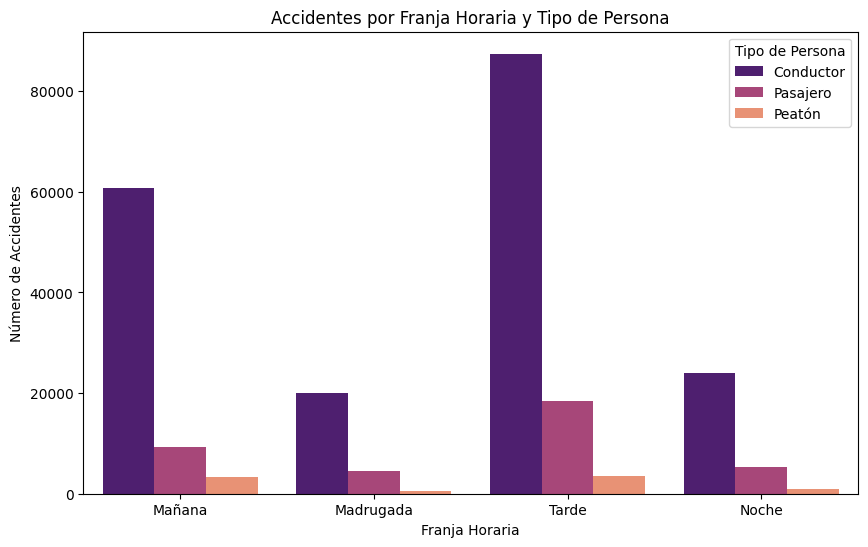

In [33]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Tramo horario', hue='Implicado', palette='magma')
plt.title('Accidentes por Franja Horaria y Tipo de Persona')
plt.xlabel('Franja Horaria')
plt.ylabel('Número de Accidentes')
plt.legend(title='Tipo de Persona')
plt.show()

### Alcohol y Drogas

#### Heatmap según positivo en drogas y alcohol por horas

In [34]:
# la columna 'hora' la convertimos en formato datetime
df['Hora'] = pd.to_datetime(df['Hora'])

# Convertir las horas a minutos desde la medianoche
df['minutos_desde_medianoche'] = df['Hora'].dt.hour * 60 + df['Hora'].dt.minute

# Definir los límites de los intervalos de una hora
intervalos = np.arange(0, 1441, 60)  # 1 hora = 60 minutos, desde las 00:00 hasta las 24:00

# Aplicar pd.cut para agrupar los minutos en intervalos de una hora
df['intervalo_hora'] = pd.cut(df['minutos_desde_medianoche'], bins=intervalos, labels=[f'{i}:00-{i+1}:00' for i in range(24)], right=False)

# Crear etiquetas descriptivas para los resultados de las pruebas
df['etiqueta_positiva_alcohol'] = df['Positivo alcohol'].map({0: 'Negativo alcohol', 1: 'Positivo alcohol'})
df['etiqueta_positiva_droga'] = df['Positivo alcohol'].map({0: 'Negativo droga', 1: 'Positivo droga'})

# Combinar las etiquetas de positiva_alcohol y positiva_droga
df['etiqueta_positivo'] = df['etiqueta_positiva_alcohol'] + ' y ' + df['etiqueta_positiva_droga']

# Filtrar los datos para eliminar los casos negativos tanto en alcohol como en drogas
df_filtered = df[(df['Positivo alcohol'] == 1) | (df['Positivo droga'] == 1)]

# Crear un diccionario de mapeo para las etiquetas más cortas o claras
etiqueta_mapeo = {
    'Positivo alcohol y Negativo droga': 'Positivo Alcohol',
    'Negativo alcohol y Positivo droga': 'Positivo Droga',
    'Positivo alcohol y Positivo droga': 'Positivo Alcohol y Droga'
}

# Reemplazar las etiquetas en el DataFrame
df_filtered['etiqueta_positivo'] = df_filtered['etiqueta_positivo'].replace(etiqueta_mapeo)

# Agrupar y sumar los datos por intervalo de horas, día de la semana y etiqueta de positivo
agrupados = df_filtered.groupby(['Día semana', 'intervalo_hora', 'etiqueta_positivo']).size().reset_index(name='cantidad')

# Crear el heatmap con Plotly
heatmap_fig = px.density_heatmap(
    agrupados,
    x='intervalo_hora',
    y='Día semana',
    z='cantidad',
    facet_col='etiqueta_positivo',
    color_continuous_scale='magma',
    title='Distribución de Accidentes Positivos por Alcohol/Drogas según Intervalo de Hora y Día de la Semana'
)

heatmap_fig.update_layout(
    xaxis_title='Intervalo de Hora del Accidente',
    yaxis_title='Día de la Semana',
    coloraxis_colorbar=dict(title='Cantidad e accidentes'),
    font=dict(family='Arial', size=12, color='white'),
    paper_bgcolor='black',
    plot_bgcolor='black'
)

heatmap_fig.update_xaxes(showgrid=False, zeroline=False, color='white')
heatmap_fig.update_yaxes(showgrid=False, zeroline=False, color='white')

heatmap_fig.show()

/var/folders/65/_g6ddtr92xxbb_g14sth8m800000gn/T/ipykernel_888/480969711.py:2: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

/var/folders/65/_g6ddtr92xxbb_g14sth8m800000gn/T/ipykernel_888/480969711.py:31: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



#### Scatter segun el positivo de drogas y alcohol por hora

In [35]:
# Convertir la columna 'hora' a formato de tiempo
df['Hora'] = pd.to_datetime(df['Hora'])

# Convertir las horas a minutos desde la medianoche
df['minutos_desde_medianoche'] = df['Hora'].dt.hour * 60 + df['Hora'].dt.minute

# Definir los límites de los intervalos de una hora
intervalos = np.arange(60, 1441, 60)  # 1 hora = 60 minutos, desde las 00:00 hasta las 23:00

# Aplicar pd.cut para agrupar los minutos en intervalos de una hora
df['intervalo_hora'] = pd.cut(df['minutos_desde_medianoche'], bins=intervalos, labels=[f'{i}:00-{i+1}:00' for i in range(0, 23)], right=False)

# Definir un orden personalizado para los intervalos de hora
orden_horas = [f'{i}:00-{i+1}:00' for i in range(7, 24)] + [f'{i}:00-{i+1}:00' for i in range(0, 7)]

# Mapear los valores de positivo a colores discretos
color_map = { 
    'Positivo alcohol y Negativo droga': 'lightblue', 
    'Negativo alcohol y Positivo droga': 'yellow', 
    'Positivo alcohol y Positivo droga': 'red'
}

# Crear el gráfico de dispersión con color y tamaño
scatter_fig = px.scatter(
    agrupados,
    x='intervalo_hora',
    y='Día semana',
    color='etiqueta_positivo',
    color_discrete_map=color_map,  # Mapear los valores de positivo a colores discretos
    size='cantidad',  # Ajustar el tamaño de las burbujas si lo prefieres
    #hover_name='Tipo accidente',
    labels={'intervalo_hora': 'Intervalo de Hora del Accidente', 'Día semana': 'Día de la Semana', 'etiqueta_positivo': 'Resultado Pruebas Alcohol/Drogas'},
    title='Relación entre Intervalo de Hora y Día del Accidente, Pruebas Positivas de Alcohol/Drogas',
    category_orders={'intervalo_hora': orden_horas}  # Ordenar las horas
)

# Ajustar el diseño de la gráfica
scatter_fig.update_layout(
    xaxis_title='Intervalo de Hora del Accidente',
    yaxis_title='Día del Accidente',
    plot_bgcolor='white', 
    paper_bgcolor='white',  
    font=dict(family='Arial', size=12, color='black'),  # Personalizar la fuente
    legend=dict(title_font=dict(size=12), font=dict(size=10)),  # Personalizar la leyenda
    margin=dict(l=50, r=50, t=80, b=50),  # Ajustar los márgenes
    #hovermode='x'  # Activar el modo hover
)

scatter_fig.update_traces(marker_line_color='rgb(8,48,107)', marker_line_width=1.5)
scatter_fig.show()

#### 3 quesitos positivo alcohol, drogas y ambos

### Tipo de día

#### Número de accidentes según el tipo de día

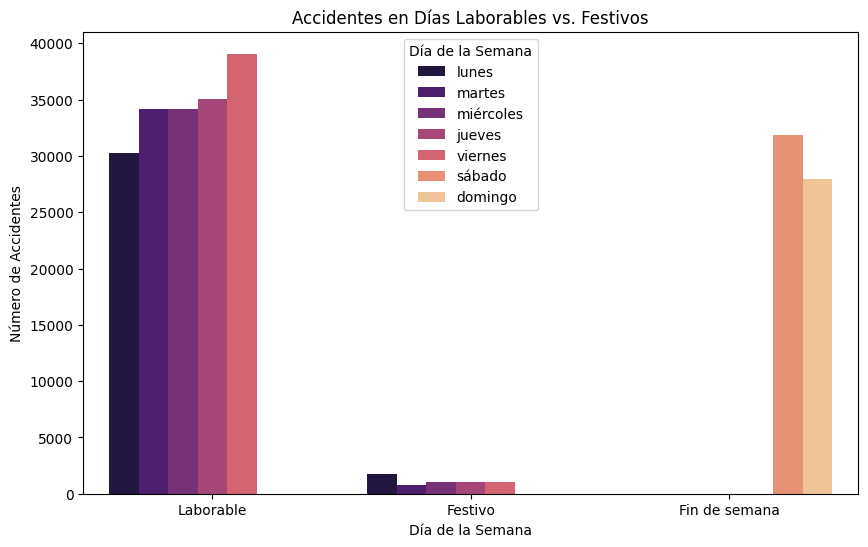

In [36]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Tipo día', hue='Día semana', palette='magma')
plt.title('Accidentes en Días Laborables vs. Festivos')
plt.xlabel('Día de la Semana')
plt.ylabel('Número de Accidentes')
plt.legend(title='Día de la Semana')
plt.show()

### Clima

#### Relación entre el estado meteorológico y el tipo de accidente

Intentar hacer ocn el plotly go, interactivo

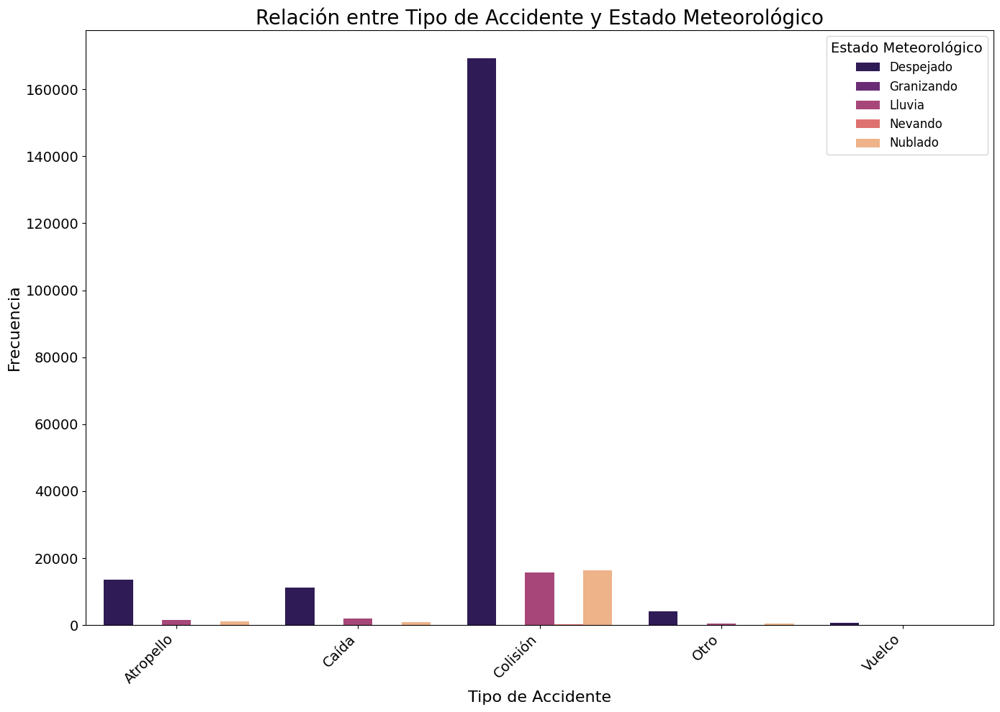

In [37]:
# Crear una tabla de frecuencia cruzada (crosstab), para contar la frecuencia de cada combinación.
crosstab = pd.crosstab(df['Tipo accidente'], df['Estado meteorológico'])

# Crear un DataFrame a partir del crosstab para facilitar el plotting
# Usamos la fución melt para aplanar la tabla cruzada en un formado adeacuado para sns
crosstab_df = crosstab.reset_index().melt(id_vars='Tipo accidente')

# Crear un gráfico de barras agrupadas usando seaborn
plt.figure(figsize=(14, 10))
sns.barplot(data=crosstab_df, x='Tipo accidente', y='value', hue='Estado meteorológico', palette='magma')

# Personalizar el gráfico
plt.title('Relación entre Tipo de Accidente y Estado Meteorológico', fontsize=20)
plt.xlabel('Tipo de Accidente', fontsize=16)
plt.ylabel('Frecuencia', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=14)
plt.yticks(fontsize=14)
plt.legend(title='Estado Meteorológico', fontsize=12, title_fontsize=14)

# Ajustar el diseño para evitar que las etiquetas se corten
plt.tight_layout()

# Mostrar el gráfico
plt.show()

#### Crosstab entre tipo de accidente y estado meteorológico

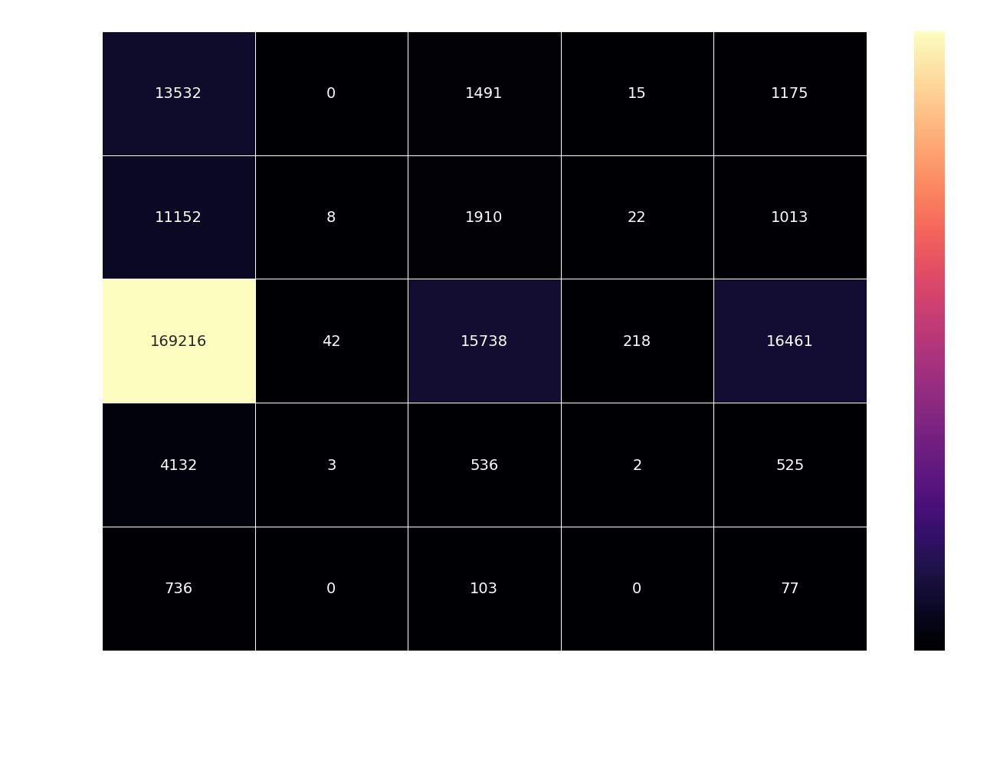

In [38]:
# Crear una tabla de frecuencia cruzada (crosstab), para contar la frecuencia de cada combinación.
crosstab = pd.crosstab(df['Tipo accidente'], df['Estado meteorológico'])

# Crear un mapa de calor usando seaborn
plt.figure(figsize=(14, 10))

# Configurar el fondo negro y las letras blancas
plt.style.use('dark_background')

# Crear el heatmap con cmap personalizado y aumentar el tamaño de las anotaciones
heatmap = sns.heatmap(crosstab, annot=True, fmt="d", cmap="magma", cbar=True, linewidths=.5, linecolor='white', annot_kws={"size": 14})

# Personalizar el título y las etiquetas en blanco y aumentar su tamaño
heatmap.set_title('Relación entre Tipo de Accidente y Estado Meteorológico', color='white', fontsize=20)
heatmap.set_xlabel('Estado Meteorológico', color='white', fontsize=16)
heatmap.set_ylabel('Tipo de Accidente', color='white', fontsize=16)

# Cambiar color de los ticks y sus etiquetas a blanco y aumentar su tamaño
heatmap.tick_params(axis='x', colors='white', labelsize=14)
heatmap.tick_params(axis='y', colors='white', labelsize=14)

# Rotar las etiquetas del eje x para que sean más legibles
plt.xticks(rotation=45, ha='right', color='white', fontsize=14)
plt.yticks(rotation=0, color='white', fontsize=14)

# Ajustar el diseño para evitar que las etiquetas se corten
plt.tight_layout()

# Mostrar el gráfico
plt.show()

#### Distribución de accidentes según el estado meteorológico

In [39]:
# Contar el número de accidentes por estado meteorológico
accidentes_por_estado = df.groupby('Estado meteorológico')['Expediente'].nunique().reset_index()
accidentes_por_estado.columns = ['Estado Meteorológico', 'Cantidad de Accidentes']

# Ordenar los datos por la cantidad de accidentes
accidentes_por_estado = accidentes_por_estado.sort_values(by='Cantidad de Accidentes', ascending=False)

# Crear el gráfico de barras
fig = px.bar(
    accidentes_por_estado,
    x='Estado Meteorológico',
    y='Cantidad de Accidentes',
    title='Distribución de Accidentes por Estado Meteorológico (Agrupado por Número de Expediente Único)',
    labels={'Estado Meteorológico': 'Estado Meteorológico', 'Cantidad de Accidentes': 'Cantidad de Accidentes'},
    color='Cantidad de Accidentes',
    color_continuous_scale='Viridis'
)

# Añadir etiquetas de datos
fig.update_traces(texttemplate='%{y:.0f}', textposition='outside', textfont=dict(color='white'))

# Ajustar el diseño del gráfico
fig.update_layout(
    title={
        'text': 'Distribución de Accidentes por Estado Meteorológico',
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title='Estado Meteorológico',
    yaxis_title='Cantidad de Accidentes',
    template='plotly_dark',  
    font=dict(family='Arial', size=12, color='white'),  # Personalizar la fuente
    margin=dict(l=50, r=50, t=80, b=50),  # Ajustar los márgenes
    height=500,  # Ajustar la altura del gráfico
    width=1000  # Ajustar el ancho del gráfico
)

fig.show()

### Distritos

#### Frecuencia de accidentes por distrito

In [40]:
fig = px.bar(df['Distrito'].value_counts(), 
            orientation='h', 
            title='Frecuencia de Accidentes por Distrito', 
            color=df['Distrito'].value_counts(), 
            color_continuous_scale='Blues', 
            labels={'color': ''})
fig.update_layout(yaxis_title='Distrito', 
                xaxis_title='Número de Accidentes', 
                yaxis={'categoryorder':'total ascending'})
fig.show()

fig.write_html("accidentes_distrito.html")

### Paso del tiempo

#### Número de accidentes por mes

In [41]:
# Asegurarse de que la columna 'fecha' está en formato datetime
df['Fecha'] = pd.to_datetime(df['Fecha'])

# Calcular el número de accidentes por mes
accidentes_por_mes = df.groupby(df['Fecha'].dt.month)['Expediente'].nunique().reset_index()
accidentes_por_mes.columns = ['Mes', 'Cantidad']

# Calcular la media de accidentes por mes
media_accidentes = accidentes_por_mes['Cantidad'].mean()

# Crear el gráfico de línea con áreas sombreadas
fig = px.line(accidentes_por_mes, x='Mes', y='Cantidad', 
            title='Tendencia de Accidentes por Mes',
            labels={'Mes': 'Mes', 'Cantidad': 'Número de Accidentes'},
            line_shape='spline', render_mode='svg')

# Ajustar aspectos visuales del gráfico
fig.update_traces(line=dict(width=3, color='#636EFA'), 
                marker=dict(size=8, color='#636EFA', line=dict(width=1, color='Black')),
                mode='lines+markers', fill='tozeroy')

# Añadir una línea que represente la media de accidentes por mes
fig.add_shape(type='line', 
            x0=accidentes_por_mes['Mes'].min(), x1=accidentes_por_mes['Mes'].max(), 
            y0=media_accidentes, y1=media_accidentes,
            line=dict(color='red', width=2, dash='dash'),
            xref='x', yref='y')

# Añadir anotación para la media
fig.add_annotation(x=accidentes_por_mes['Mes'].max(), y=media_accidentes, 
                text=f'Media: {media_accidentes:.2f}', 
                showarrow=True, arrowhead=2, ax=0, ay=-40)

# Actualizar el layout del gráfico
fig.update_layout(xaxis=dict(tickmode='linear', dtick=1, title='Mes'),
                yaxis=dict(title='Número de Accidentes'),
                plot_bgcolor='rgba(0,0,0,0)', paper_bgcolor='rgba(0,0,0,0)',
                font=dict(color='white', size=12),
                title_font=dict(size=20))

# Mostrar el gráfico
fig.show()

#### Accidentes por años y meses

In [42]:
import plotly.express as px

# Convertir la columna 'Fecha' al formato de Fecha adecuado
df['Fecha'] = pd.to_datetime(df['Fecha'])

# Agrupar por año y mes y contar las ocurrencias
total_por_año_mes = df.groupby([df['Fecha'].dt.year.rename('Año'), 
                                df['Fecha'].dt.month.rename('Mes')])['Expediente'].nunique().reset_index(name='cantidad')

# Convertir el número de mes en un objeto datetime
total_por_año_mes['Mes'] = pd.to_datetime(total_por_año_mes['Mes'], format='%m').dt.strftime('%B')

# Graficar utilizando Plotly Express
fig = px.line(total_por_año_mes, x='Mes', y='cantidad', color='Año', 
            color_discrete_sequence=px.colors.sequential.Viridis)
fig.show()

fig.write_html("accidentes_mes_año_viridis.html")


In [43]:
# Convertir la columna 'fecha' al formato de fecha adecuado
df['Fecha'] = pd.to_datetime(df['Fecha'])

# Agrupar por año y mes y contar las ocurrencias
total_por_año_mes = df.groupby([df['Fecha'].dt.year.rename('Año'), 
                                df['Fecha'].dt.month.rename('Mes')])['Expediente'].nunique().reset_index(name='cantidad')

# Convertir el número de mes en un objeto datetime
total_por_año_mes['Mes'] = pd.to_datetime(total_por_año_mes['Mes'], format='%m').dt.strftime('%B')

# # Mostrar el resultado
# print(total_por_año_mes)

# Graficar utilizando Plotly Express
fig = px.line(total_por_año_mes, x='Mes', y='cantidad', color='Año')
fig.show()

fig.write_html("accidentes_mes_año.html")


In [44]:
import plotly.express as px

# Convertir la columna 'fecha' al formato de fecha adecuado
df['Fecha'] = pd.to_datetime(df['Fecha'])

# Agrupar por año y contar las ocurrencias
total_por_año = df.groupby(df['Fecha'].dt.year)['Expediente'].nunique().reset_index(name='total_accidentes')

# Graficar utilizando Plotly Express
fig = px.bar(total_por_año, x='Fecha', y='total_accidentes', labels={'Fecha': 'Año', 'total_accidentes': 'Total de Accidentes'},
            color='total_accidentes', color_continuous_scale='Blues')
fig.update_layout(title='Total de Accidentes por Año', xaxis_title='Año', yaxis_title='Total de Accidentes')
fig.show()

fig.write_html("accidentes_año.html")


In [45]:

copia = df.copy()
# Convertir la columna 'fecha' al formato de fecha adecuado
copia['Fecha'] = pd.to_datetime(copia['Fecha'])

# Establecer la columna 'fecha' como índice del DataFrame
copia = copia.set_index('Fecha')

# Obtener el año actual
año_actual = pd.Timestamp.now().year

# Determinar cuántas filas y columnas necesitas para tus subgráficos
num_filas = (año_actual - copia.index.min().year + 1) // 3 + ((año_actual - copia.index.min().year + 1) % 2)
num_columnas = 3

# Lista para almacenar los datos de todos los años
datos_por_año = []

# Crear gráficos separados para cada año y calcular el rango máximo y mínimo de los datos
for i, año in enumerate(range(copia.index.min().year, año_actual + 1)):
    # Filtrar el DataFrame para el año actual
    copia_año = copia[copia.index.year == año]
    
    # Agrupar por mes y contar las ocurrencias
    total_por_mes = copia_año.resample('M')['Expediente'].nunique().reset_index(name='cantidad')
    
    # Agregar los datos de este año a la lista
    datos_por_año.append(total_por_mes['cantidad'])
    
# Calcular el rango máximo y mínimo de todos los datos
y_min = min([min(datos) for datos in datos_por_año])
y_max = max([max(datos) for datos in datos_por_año])

# Crear una figura con subplots
fig = make_subplots(rows=num_filas, cols=num_columnas, subplot_titles=[f'Año {año}' for año in range(copia.index.min().year, año_actual + 1)],
                    vertical_spacing=0.15)

# Definir una paleta de colores
palette = px.colors.qualitative.Plotly

# Crear gráficos separados para cada año y agregarlos a las subtramas
for i, año in enumerate(range(copia.index.min().year, año_actual + 1)):
    # Filtrar el DataFrame para el año actual
    copia_año = copia[copia.index.year == año]
    
    # Agrupar por mes y contar las ocurrencias
    total_por_mes = copia_año.resample('M')['Expediente'].nunique().reset_index(name='cantidad')
    
    # Obtener el nombre del mes en español
    total_por_mes['mes'] = total_por_mes['Fecha'].dt.strftime('%B')
    
    # Seleccionar un color de la paleta para este año
    color = palette[i % len(palette)]
    
    # Calcular la fila y columna para esta subtrama
    fila = i // num_columnas + 1
    columna = i % num_columnas + 1
    
    # Agregar el gráfico a la subtrama correspondiente
    fig.add_trace(
        go.Scatter(x=total_por_mes['mes'], y=total_por_mes['cantidad'], name=f'Año {año}', line=dict(color=color)),
        row=fila,
        col=columna
    )

# Establecer el mismo rango en el eje y para todos los subgráficos
fig.update_yaxes(range=[y_min, y_max])

# Actualizar el diseño de las subtramas
fig.update_layout(height=1000, width=1300, showlegend=False, title='Accidentes por mes en cada año')

# Mostrar la figura
pio.show(fig)


In [46]:


# Convertir la columna 'fecha' al formato de fecha adecuado
df['Fecha'] = pd.to_datetime(df['Fecha'])

# Agrupar por fecha y contar las ocurrencias
total_por_año_mes = df.groupby('Fecha')['Expediente'].nunique().reset_index(name='cantidad')

# Graficar utilizando Plotly Express
fig = px.line(total_por_año_mes, x='Fecha', y='cantidad',
              hover_data={"Fecha": "|%B %d, %Y"},
              title='Cantidad de Accidentes por Fecha')
fig.update_xaxes(
    dtick="M1",
    tickformat="%b\n%Y",
    ticklabelmode="period",
    rangeslider_visible=True,
    minor=dict(ticks="inside", showgrid=True),
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ]),
        bgcolor='rgba(0,0,0,0.7)',  # Color de fondo negro con opacidad
        font=dict(color='white')  # Color del texto blanco
    ))
fig.update_traces(line=dict(color='green'))  # Cambiar el color de la línea a rojo
# Mostrar el gráfico
fig.show()


In [47]:
# Convertir la columna 'fecha' al formato de fecha adecuado
total_por_año_mes['Fecha'] = pd.to_datetime(total_por_año_mes['Fecha'])

# Ordenar los datos por fecha
total_por_año_mes = total_por_año_mes.sort_values(by='Fecha')

fig = px.line(total_por_año_mes, x='Fecha', y='cantidad', title='Serie Temporal con Control Deslizante de Rango y Selectores')

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ]),
        bgcolor='rgba(0,0,0,0.7)',  # Color de fondo negro con opacidad
        font=dict(color='white')  # Color del texto blanco
    )
)
fig.show()


### Mapas

#### Mapa de calor

In [48]:
# Crear el objeto mapa centrado en la ubicación media de tus datos
mapa = folium.Map(location=[df['Latitud'].mean(), df['Longitud'].mean()], zoom_start=12)

# Preparar los datos para el mapa de calor
# Convertimos las coordenadas a una lista de listas
coordenadas = df[['Latitud', 'Longitud']].dropna().values.tolist()

# Añadir el HeatMap al mapa
HeatMap(coordenadas).add_to(mapa)

# Guardar el mapa en un archivo HTML
mapa.save('mapa_de_calor.html')

# Mostrar el mapa en un Jupyter Notebook (opcional)
mapa

#### Mapa de puntos

In [49]:
# Crear un gráfico de dispersión en el mapa con colores por distrito
fig = px.scatter_mapbox(df, lat="Latitud", lon="Longitud", hover_name="Expediente",
                        color="Distrito", zoom=10, color_discrete_sequence=px.colors.qualitative.Dark24)

# Personalizar la apariencia del mapa
fig.update_layout(mapbox_style="carto-positron", mapbox_zoom=10, mapbox_center = {"lat": 40.4167, "lon": -3.70325})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# Mostrar el mapa
fig.show()

#### Nube de palabras

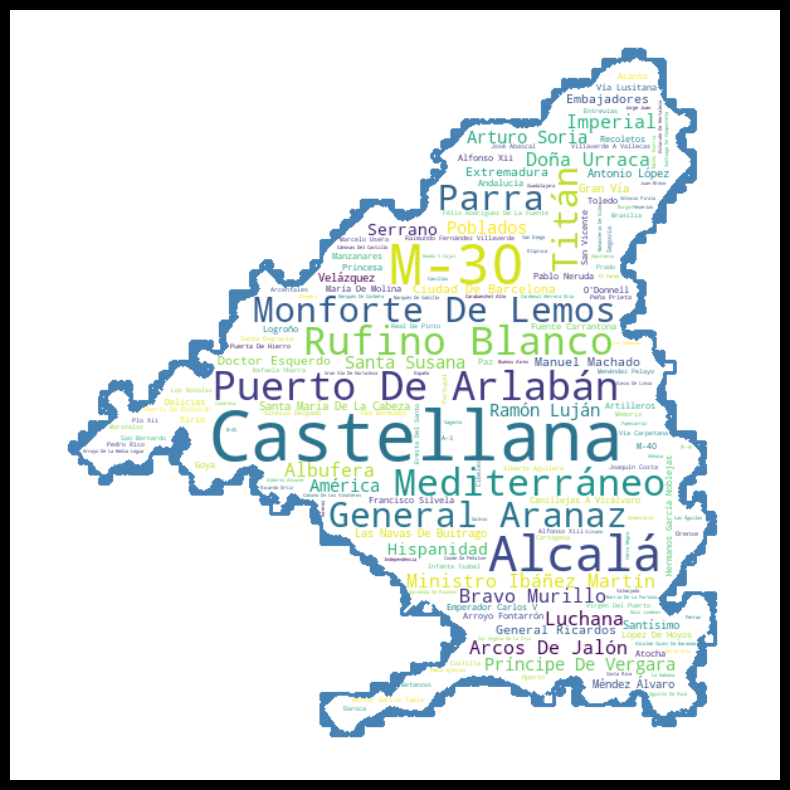

In [50]:
# Cargar la imagen de la máscara
mascara = np.array(Image.open("mapa_madrid.jpg"))

# Suponiendo que tienes una columna 'nombre_calle_cercana' en tu DataFrame de accidentes
# Puedes usar value_counts() para contar la frecuencia de las calles y luego convertirlo a un diccionario

# Calcular la frecuencia de las calles
frecuencia_calles = df['Calle'].value_counts()

# Convertir la Serie de pandas a un diccionario
calles_dict = frecuencia_calles.to_dict()

# Crear el WordCloud con la máscara y configuraciones adicionales
wordcloud = WordCloud(background_color='white', mask=mascara, contour_color='steelblue', contour_width=2).generate_from_frequencies(calles_dict)

# Mostrar la nube de palabras centrada en el espacio disponible
plt.figure(figsize=(10, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

# Guardar la nube de palabras en un archivo temporal
wordcloud.to_file("wordcloud.png")


In [ ]:
# Cargar la imagen de la máscara
mascara = np.array(Image.open("mapa_madrid.jpg"))

# Suponiendo que tienes una columna 'nombre_calle_cercana' en tu DataFrame de accidentes
# Puedes usar value_counts() para contar la frecuencia de las calles y luego convertirlo a un diccionario

# Calcular la frecuencia de las calles
frecuencia_calles = df['Tipo vía'].value_counts()

# Convertir la Serie de pandas a un diccionario
calles_dict = frecuencia_calles.to_dict()

# Crear el WordCloud con la máscara y configuraciones adicionales
wordcloud = WordCloud(background_color='white', mask=mascara, contour_color='steelblue', contour_width=2).generate_from_frequencies(calles_dict)

# Mostrar la nube de palabras centrada en el espacio disponible
plt.figure(figsize=(10, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

# Guardar la nube de palabras en un archivo temporal
wordcloud.to_file("wordcloud2.png")